<a href="https://colab.research.google.com/github/roy-sib2002/github-pages/blob/main/new_tmax_tmin_extract.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
pip install geopandas xarray netCDF4 rioxarray pyproj shapely

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.3/9.3 MB 96.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.2/62.2 kB 6.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 102.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 77.5 MB/s eta 0:00:00


In [ ]:
import geopandas as gpd

shapefile_path = "/content/drive/MyDrive/Dissertation_Project/Dissertation_Data/godavari_basin.shp/godavari.shp"
basin = gpd.read_file(shapefile_path)
basin = basin.to_crs("EPSG:4326")


In [ ]:
import pandas as pd
from shapely.geometry import Point

csv_path = "/content/drive/MyDrive/Dissertation_Project/Dissertation_Data/fresh_data_metadata.csv"
stations_df = pd.read_csv(csv_path)
geometry = [Point(xy) for xy in zip(stations_df['Longitude'], stations_df['Latitude'])]
stations_gdf = gpd.GeoDataFrame(stations_df, geometry=geometry, crs = "EPSG:4326")


In [ ]:
import xarray as xr
rainfall_path = "/content/drive/MyDrive/Dissertation_Project/Dissertation_Data/IMD_NetCDF_Output/IMD_Rainfall_2024.nc"
ds = xr.open_dataset(rainfall_path)

print(ds)

rain = ds['rainfall'].isel(time = 0)
rain_df = rain.to_dataframe().reset_index().dropna()

<xarray.Dataset> Size: 26MB
Dimensions:   (time: 366, lat: 135, lon: 129)
Coordinates:
  * time      (time) datetime64[ns] 3kB 2024-01-01 2024-01-02 ... 2024-12-31
  * lat       (lat) float64 1kB 6.5 6.74 6.98 7.22 ... 37.78 38.02 38.26 38.5
  * lon       (lon) float64 1kB 66.5 66.76 67.02 67.29 ... 99.48 99.74 100.0
Data variables:
    rainfall  (time, lat, lon) float32 25MB ...
Attributes:
    title:        IMD Gridded Rainfall Data
    source:       IMD
    units:        mm
    description:  yearly daily rainfall data for 2024


In [ ]:
import geopandas as gpd
import pandas as pd
import xarray as xr
rain_slice = ds['rainfall'].isel(time = 0)
rain_df = rain_slice.to_dataframe().reset_index().dropna()

from shapely.geometry import Point
rain_gdf = gpd.GeoDataFrame(
    rain_df,
    geometry=gpd.points_from_xy(rain_df['lon'], rain_df['lat']),
    crs="EPSG:4326"
)
rain_in_basin = gpd.sjoin(rain_gdf, basin, how='inner', predicate='within')
print("Number of rainfall grid points inside the basin:", len(rain_in_basin))
rain_in_basin.head()

Number of rainfall grid points inside the basin: 105


,lat,lon,time,rainfall,geometry,index_right,HYBAS_ID,NEXT_DOWN,NEXT_SINK,MAIN_BAS,DIST_SINK,DIST_MAIN,SUB_AREA,UP_AREA,PFAF_ID,ENDO,COAST,ORDER_,SORT
5863,17.25,81.68,2024-01-01,0.0,POINT (81.68 17.25),0,4040027780,0,4040027780,4040027780,0.0,0.0,310377.2,310380.1,4534,0,0,1,93
5864,17.25,81.94,2024-01-01,0.0,POINT (81.94 17.25),0,4040027780,0,4040027780,4040027780,0.0,0.0,310377.2,310380.1,4534,0,0,1,93
5978,17.49,78.02,2024-01-01,0.0,POINT (78.02 17.49),0,4040027780,0,4040027780,4040027780,0.0,0.0,310377.2,310380.1,4534,0,0,1,93
5979,17.49,78.28,2024-01-01,0.0,POINT (78.28 17.49),0,4040027780,0,4040027780,4040027780,0.0,0.0,310377.2,310380.1,4534,0,0,1,93
5988,17.49,80.63,2024-01-01,0.0,POINT (80.63 17.49),0,4040027780,0,4040027780,4040027780,0.0,0.0,310377.2,310380.1,4534,0,0,1,93


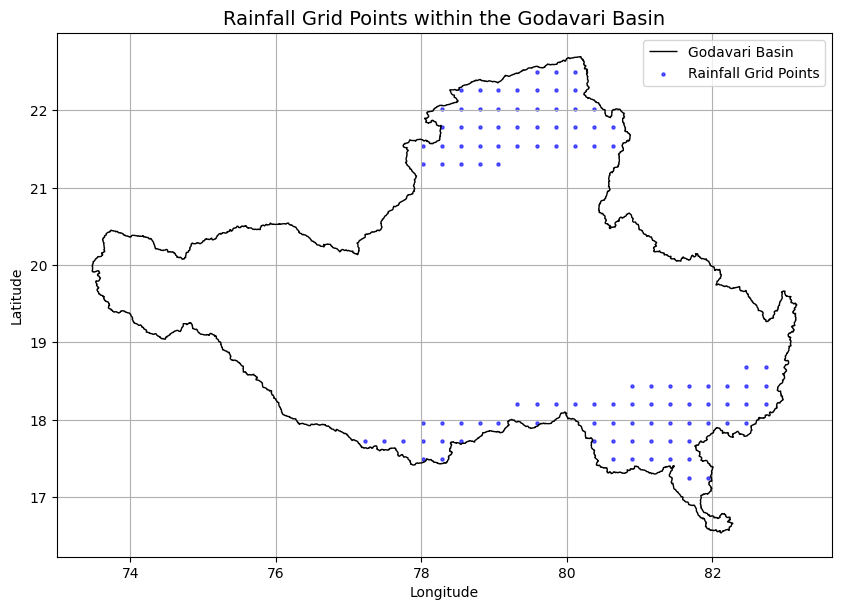

In [ ]:
import matplotlib.pylab as plt
fig, ax = plt.subplots(figsize = (10, 10))
basin.boundary.plot(ax=ax, edgecolor='black', linewidth=1, label="Godavari Basin")
rain_in_basin.plot(ax=ax, color='blue', markersize=5, alpha=0.6, label="Rainfall Grid Points")
plt.title("Rainfall Grid Points within the Godavari Basin", fontsize=14)
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.legend()

plt.grid(True)
plt.show()

In [ ]:
import pandas as pd
gauging_csv_path = "/content/drive/MyDrive/Dissertation_Project/Dissertation_Data/fresh_data_metadata.csv"
gauging_df = pd.read_csv(gauging_csv_path)
print(gauging_df.columns)



Index(['Sl No.', 'IWRIS_ID', 'Stn_ID', 'Stn_Name', 'Latitude', 'Longitude',
       'Catchment_Area', 'Tributary_Name', 'Basin_Name', 'Start_Year',
       'End_Year', 'Gauge_Type', 'Years'],
      dtype='object')


In [ ]:
from shapely.geometry import Point

gauging_gdf = gpd.GeoDataFrame(
    gauging_df,
    geometry=gpd.points_from_xy(gauging_df['Longitude'], gauging_df['Latitude']),
    crs="EPSG:4326"
)


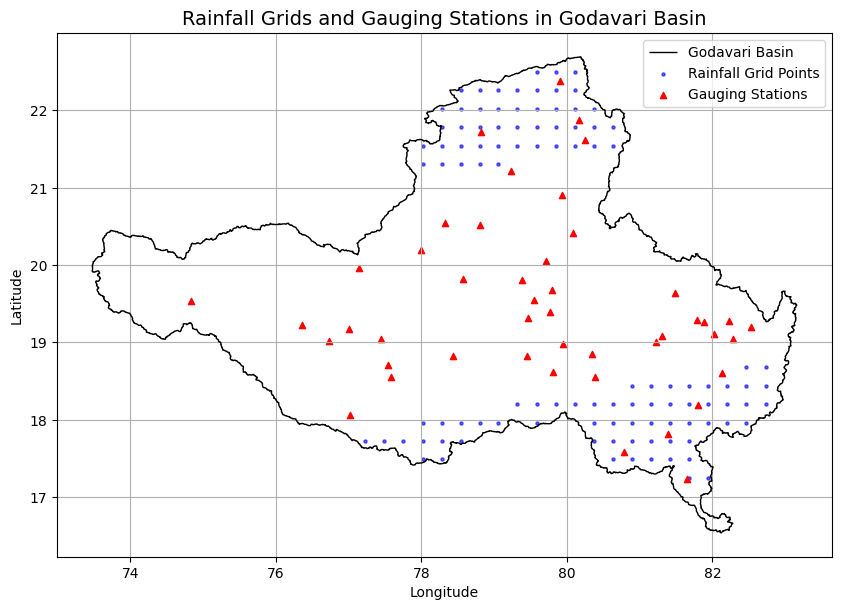

In [ ]:
fig, ax = plt.subplots(figsize=(10, 10))
basin.boundary.plot(ax=ax, edgecolor='black', linewidth=1, label="Godavari Basin")
rain_in_basin.plot(ax=ax, color='blue', markersize=5, alpha=0.6, label="Rainfall Grid Points")
gauging_gdf.plot(ax=ax, color='red', markersize=20, marker='^', label="Gauging Stations")
plt.title("Rainfall Grids and Gauging Stations in Godavari Basin", fontsize=14)
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
def get_nearest_rainfall(gauging_station, rainfall_gdf, rainfall_data):
    station_coords = (gauging_station['Latitude'], gauging_station['Longitude'])

    # Find nearest grid point
    nearest_point = None
    min_distance = float('inf')

    for idx, row in rainfall_gdf.iterrows():
        grid_coords = (row['lat'], row['lon'])
        distance = geodesic(station_coords, grid_coords).meters
        if distance < min_distance:
            min_distance = distance
            nearest_point = row

    # Get indices in dataset
    nearest_lat = nearest_point['lat']
    nearest_lon = nearest_point['lon']
    lat_idx = np.where(rainfall_data['lat'].values == nearest_lat)[0][0]
    lon_idx = np.where(rainfall_data['lon'].values == nearest_lon)[0][0]

    # Extract full time series
    rainfall_series = rainfall_data.isel(lat=lat_idx, lon=lon_idx).to_series()

    return nearest_lon, nearest_lat, rainfall_series, min_distance


In [ ]:
rainfall_records = {}

for idx, station in gauging_gdf.iterrows():
    lon, lat, series, distance = get_nearest_rainfall(station, rain_in_basin, ds['rainfall'])
    station_id = station['Stn_ID']  # Replace with your actual column name
    rainfall_records[station_id] = {
        'Longitude': lon,
        'Latitude': lat,
        'Distance_m': distance,
        'Rainfall_TimeSeries': series
    }

# Example: Print rainfall time series for one station
example_station = list(rainfall_records.keys())[0]
print(f"Rainfall at {example_station}:\n", rainfall_records[example_station]['Rainfall_TimeSeries'].head())


Rainfall at GPAC02:
 time
2024-01-01    0.0
2024-01-02    0.0
2024-01-03    0.0
2024-01-04    0.0
2024-01-05    0.0
Name: rainfall, dtype: float32


In [ ]:
pip install seaborn


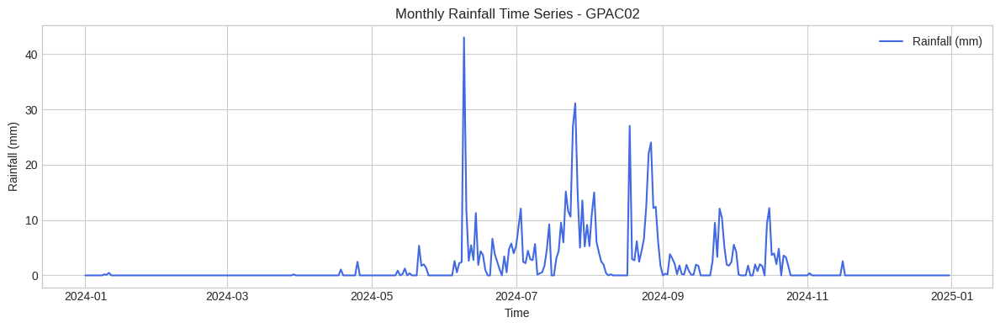

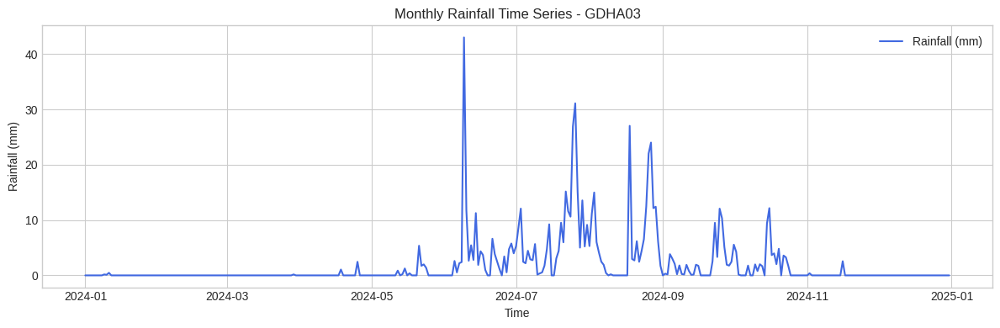

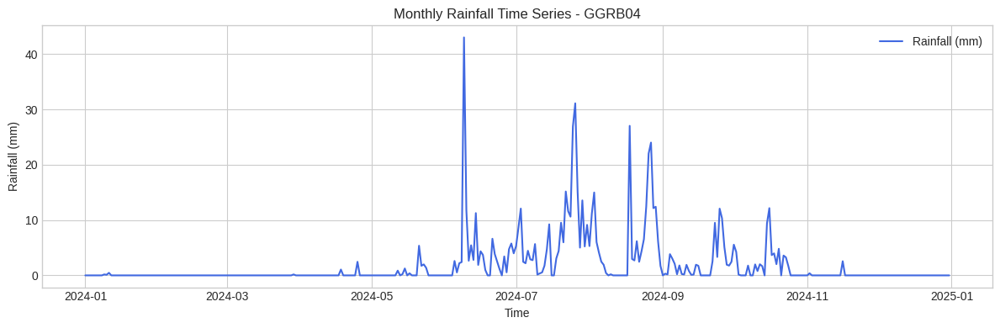

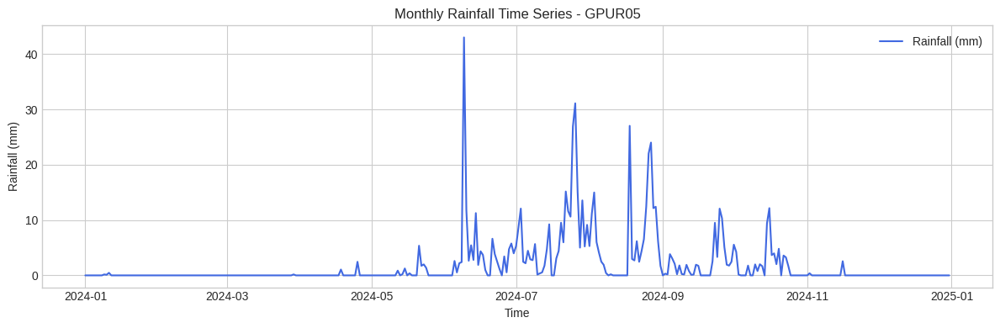

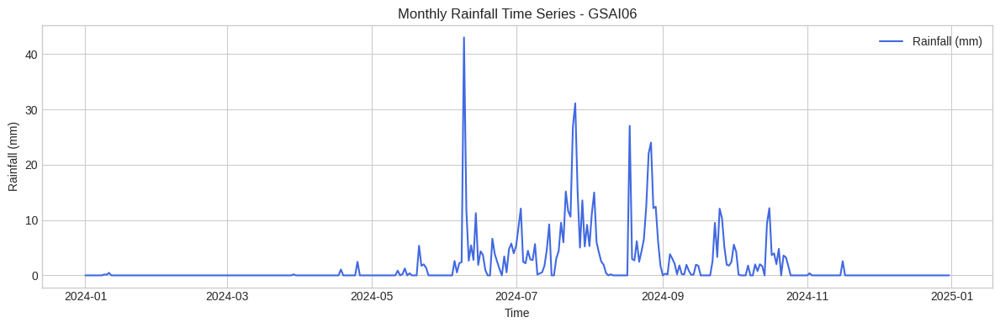

In [ ]:
import matplotlib.pyplot as plt

# Use default or a safe built-in style
plt.style.use('seaborn-v0_8-whitegrid')  # Or comment this line for default

# Preview only the first 5 station time series
for i, (station_id, data) in enumerate(rainfall_records.items()):
    if i >= 5:
        break
    series = data['Rainfall_TimeSeries']

    plt.figure(figsize=(12, 4))
    plt.plot(series.index, series.values, label='Rainfall (mm)', color='royalblue')
    plt.title(f"Monthly Rainfall Time Series - {station_id}")
    plt.xlabel("Time")
    plt.ylabel("Rainfall (mm)")
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()


In [ ]:
import matplotlib.pyplot as plt
print(plt.style.available)


['Solarize_Light2', '_classic_test_patch', '_mpl-gallery', '_mpl-gallery-nogrid', 'bmh', 'classic', 'dark_background', 'fast', 'fivethirtyeight', 'ggplot', 'grayscale', 'petroff10', 'seaborn-v0_8', 'seaborn-v0_8-bright', 'seaborn-v0_8-colorblind', 'seaborn-v0_8-dark', 'seaborn-v0_8-dark-palette', 'seaborn-v0_8-darkgrid', 'seaborn-v0_8-deep', 'seaborn-v0_8-muted', 'seaborn-v0_8-notebook', 'seaborn-v0_8-paper', 'seaborn-v0_8-pastel', 'seaborn-v0_8-poster', 'seaborn-v0_8-talk', 'seaborn-v0_8-ticks', 'seaborn-v0_8-white', 'seaborn-v0_8-whitegrid', 'tableau-colorblind10']


In [4]:
import xarray as xr
import pandas as pd
from shapely.geometry import Point
from geopy.distance import geodesic

tmax_path = '/content/drive/MyDrive/Dissertation_Project/Dissertation_Data/t_max_netcdf/tmax_IMD_1951.nc'
tmin_path = '/content/drive/MyDrive/Dissertation_Project/Dissertation_Data/t_min_netcdf/tmin_IMD_1951.nc'

ds_tmax = xr.open_dataset(tmax_path)
ds_tmin = xr.open_dataset(tmin_path)

print(ds_tmax)
print(ds_tmin)

<xarray.Dataset> Size: 1MB
Dimensions:  (time: 365, lat: 31, lon: 31)
Coordinates:
  * time     (time) datetime64[ns] 3kB 1951-01-01 1951-01-02 ... 1951-12-31
  * lat      (lat) float64 248B 7.5 8.5 9.5 10.5 11.5 ... 34.5 35.5 36.5 37.5
  * lon      (lon) float64 248B 67.5 68.5 69.5 70.5 71.5 ... 94.5 95.5 96.5 97.5
Data variables:
    tmax     (time, lat, lon) float32 1MB ...
Attributes:
    title:        Daily Tmax from IMD file (1951)
    description:  Converted from .GRD to NetCDF
    source:       IMD
    resolution:   1.0 X 1.0
<xarray.Dataset> Size: 1MB
Dimensions:  (time: 365, lat: 31, lon: 31)
Coordinates:
  * time     (time) datetime64[ns] 3kB 1951-01-01 1951-01-02 ... 1951-12-31
  * lat      (lat) float64 248B 7.5 8.5 9.5 10.5 11.5 ... 34.5 35.5 36.5 37.5
  * lon      (lon) float64 248B 67.5 68.5 69.5 70.5 71.5 ... 94.5 95.5 96.5 97.5
Data variables:
    tmin     (time, lat, lon) float32 1MB ...
Attributes:
    title:        Daily Tmin from IMD file (1951)
    description:  

In [5]:
!pip install netCDF4 h5netcdf scipy

In [6]:
import os
import glob
import xarray
import xarray as xr
import pandas as pd
import numpy as np
start_year = 1951
end_year = 2024

tmax_folder = '/content/drive/MyDrive/Dissertation_Project/Dissertation_Data/t_max_netcdf'
tmin_folder = '/content/drive/MyDrive/Dissertation_Project/Dissertation_Data/t_min_netcdf'

In [7]:
tmax_files = sorted(glob.glob(os.path.join(tmax_folder, '*.nc')))
tmin_files = sorted(glob.glob(os.path.join(tmin_folder, '*.nc')))

import netCDF4
import scipy
ds_tmax = xr.open_mfdataset(
    tmax_files, combine = 'nested', concat_dim = 'time', engine = 'netcdf4'
)
ds_tmin = xr.open_mfdataset(
    tmin_files, combine = 'nested', concat_dim= 'time', engine = 'netcdf4'
)

In [8]:
print(ds_tmax)
print(ds_tmin)

<xarray.Dataset> Size: 104MB
Dimensions:  (time: 27029, lat: 31, lon: 31)
Coordinates:
  * time     (time) datetime64[ns] 216kB 1951-01-01 1951-01-02 ... 2024-12-31
  * lat      (lat) float64 248B 7.5 8.5 9.5 10.5 11.5 ... 34.5 35.5 36.5 37.5
  * lon      (lon) float64 248B 67.5 68.5 69.5 70.5 71.5 ... 94.5 95.5 96.5 97.5
Data variables:
    tmax     (time, lat, lon) float32 104MB dask.array<chunksize=(365, 31, 31), meta=np.ndarray>
Attributes:
    title:        Daily Tmax from IMD file (1951)
    description:  Converted from .GRD to NetCDF
    source:       IMD
    resolution:   1.0 X 1.0
<xarray.Dataset> Size: 104MB
Dimensions:  (time: 27029, lat: 31, lon: 31)
Coordinates:
  * time     (time) datetime64[ns] 216kB 1951-01-01 1951-01-02 ... 2024-12-31
  * lat      (lat) float64 248B 7.5 8.5 9.5 10.5 11.5 ... 34.5 35.5 36.5 37.5
  * lon      (lon) float64 248B 67.5 68.5 69.5 70.5 71.5 ... 94.5 95.5 96.5 97.5
Data variables:
    tmin     (time, lat, lon) float32 104MB dask.array<chunksiz

In [9]:
gauging_df = pd.read_csv('/content/drive/MyDrive/Dissertation_Project/Dissertation_Data/fresh_data_metadata.csv')
gauging_df = gauging_df[['Stn_Name', 'Latitude', 'Longitude']]

In [10]:
def extract_temperature_series(ds, var_name, stations_df):
    lats = ds['lat'].values
    lons = ds['lon'].values
    time = ds['time'].values

    result = {}

    for _, row in stations_df.iterrows():
        name = row['Stn_Name']
        lat_idx = np.abs(lats - row['Latitude']).argmin()
        lon_idx = np.abs(lons - row['Longitude']).argmin()
        series = ds[var_name][:, lat_idx, lon_idx].values
        result[name] = series

    df = pd.DataFrame(result, index=pd.to_datetime(time))
    return df


In [11]:
df_tmax = extract_temperature_series(ds_tmax, 'tmax', gauging_df)
df_tmin = extract_temperature_series(ds_tmin, 'tmin', gauging_df)


In [12]:
print(df_tmax)
print(df_tmin)

            Pachegaon  Dhalegaon  G.R. Bridge      Purna    Saigaon  \
1951-01-01  27.620001  26.969999    26.969999  27.490000  27.950001   
1951-01-02  27.610001  26.100000    26.100000  26.309999  26.950001   
1951-01-03  29.100000  26.690001    26.690001  26.020000  26.480000   
1951-01-04  28.469999  27.040001    27.040001  26.559999  27.170000   
1951-01-05  28.730000  28.290001    28.290001  27.850000  27.870001   
...               ...        ...          ...        ...        ...   
2024-12-27  29.056820  28.899296    28.899296  29.104460  28.821936   
2024-12-28  29.891495  30.547428    30.547428  30.992950  30.858126   
2024-12-29  29.961769  30.247705    30.247705  30.550743  31.760227   
2024-12-30  30.410280  30.171097    30.171097  30.452572  31.947338   
2024-12-31  30.648100  30.605289    30.605289  30.785929  31.265043   

            Kanergaon      Yelli   Betmogra    Degloor    Mangrul  ...  \
1951-01-01  27.490000  27.490000  27.950001  27.950001  26.570000  ...   

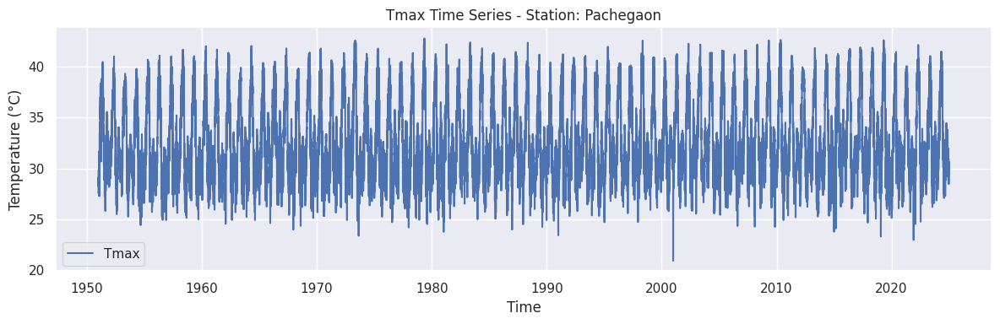

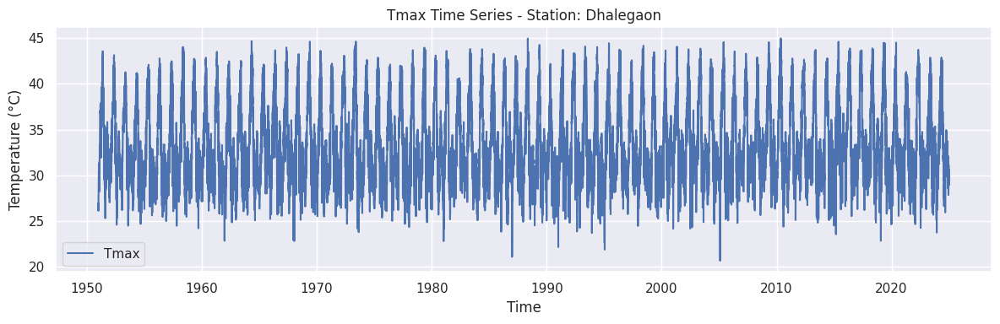

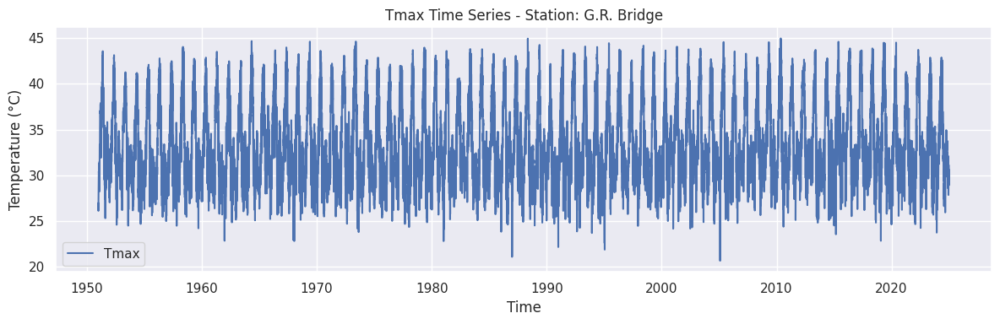

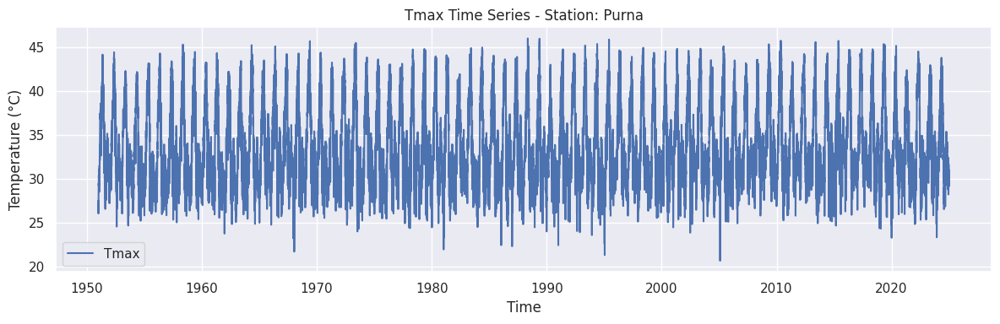

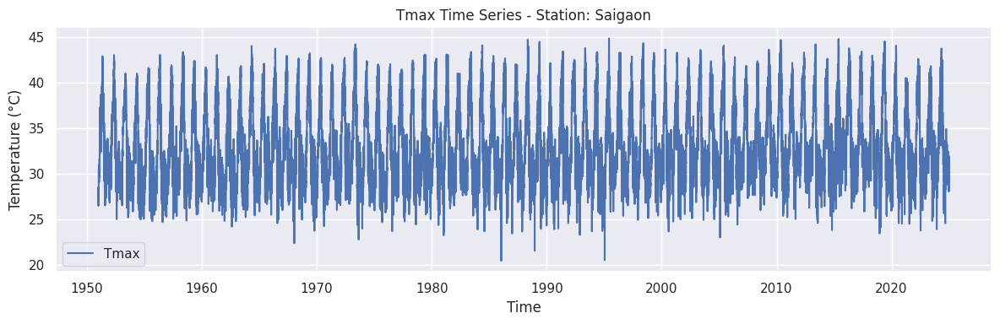

...

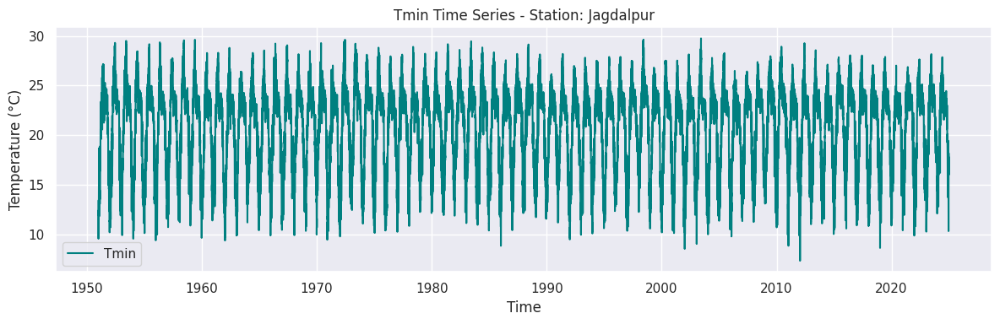

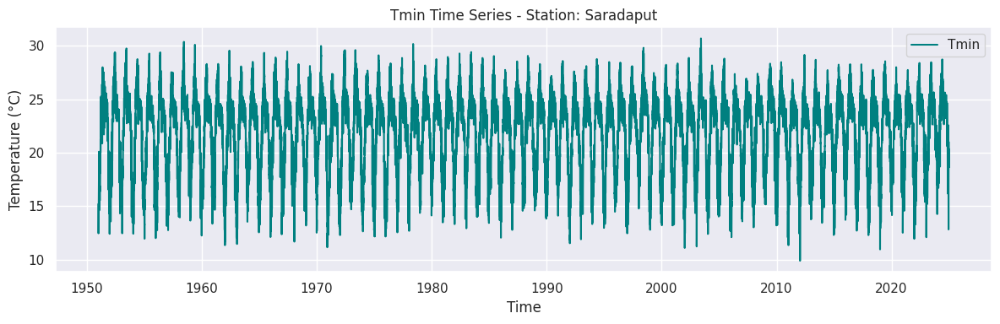

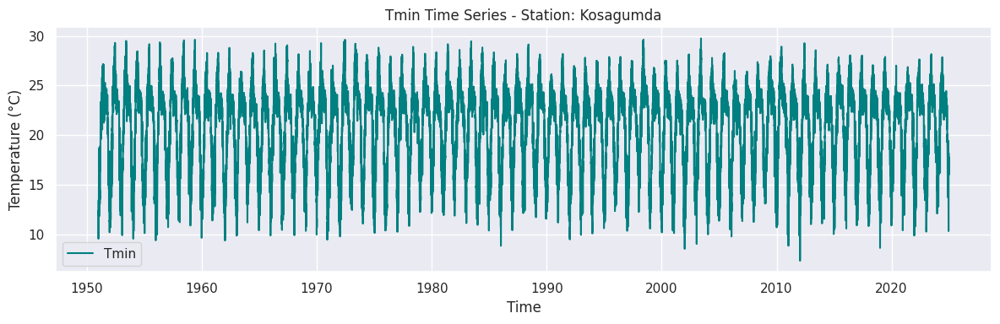

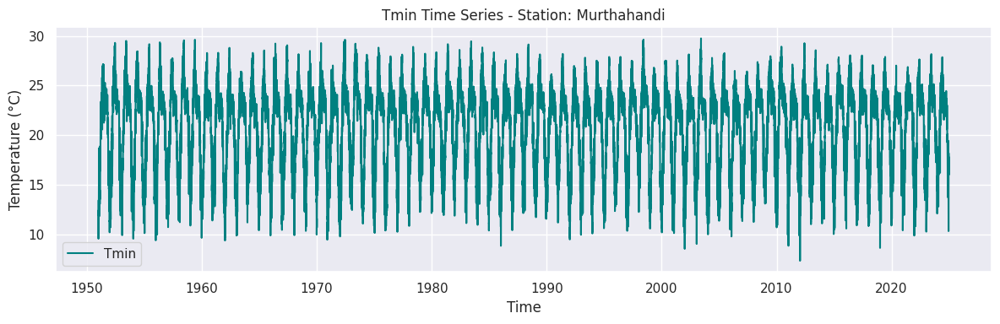

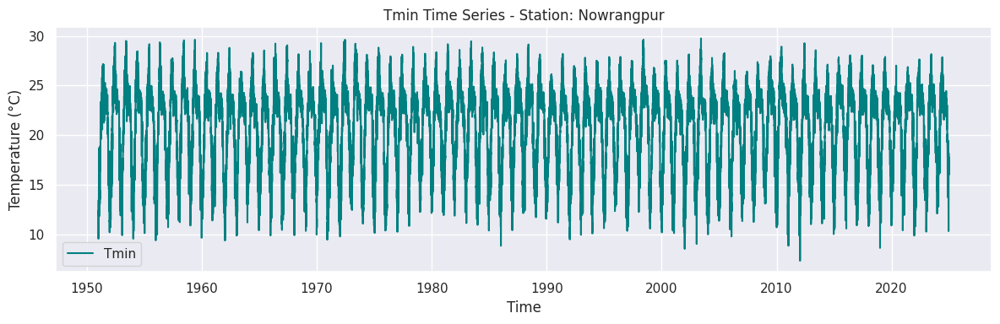

In [13]:
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_theme(style="darkgrid")

for column in df_tmax.columns:
    plt.figure(figsize=(12, 4))
    plt.plot(df_tmax.index, df_tmax[column], label='Tmax')
    plt.title(f'Tmax Time Series - Station: {column}')
    plt.xlabel('Time')
    plt.ylabel('Temperature (°C)')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()
for column in df_tmin.columns:
    plt.figure(figsize=(12, 4))
    plt.plot(df_tmin.index, df_tmin[column], label='Tmin', color='teal')
    plt.title(f'Tmin Time Series - Station: {column}')
    plt.xlabel('Time')
    plt.ylabel('Temperature (°C)')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


In [14]:

df_tmax.to_csv('/content/drive/MyDrive/Dissertation_Project/tmax_timeseries.csv')

df_tmin.to_csv('/content/drive/MyDrive/Dissertation_Project/tmin_timeseries.csv')


In [15]:
start_year = 1951
end_year = 2024

tmax_filtered = df_tmax[(df_tmax.index.year >= start_year) & (df_tmax.index.year <= end_year)]
tmin_filtered = df_tmin[(df_tmin.index.year >= start_year) & (df_tmin.index.year <= end_year)]


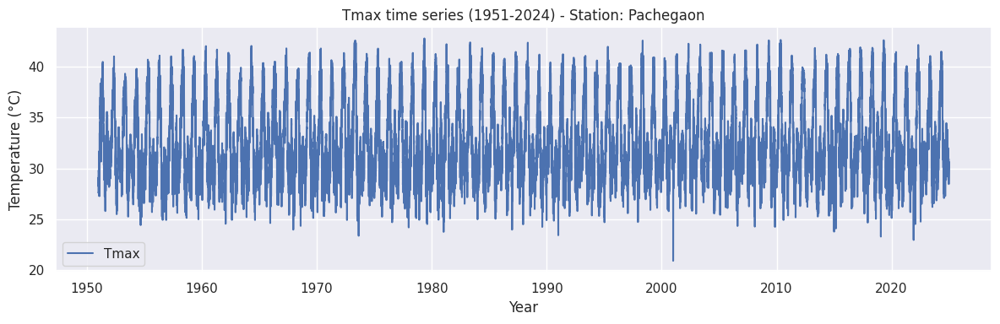

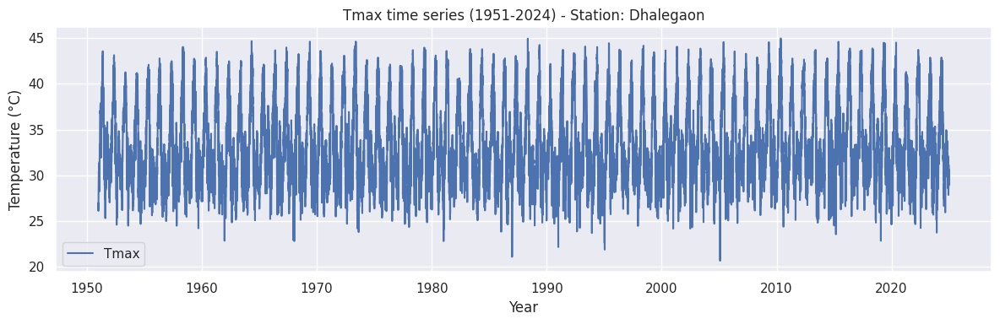

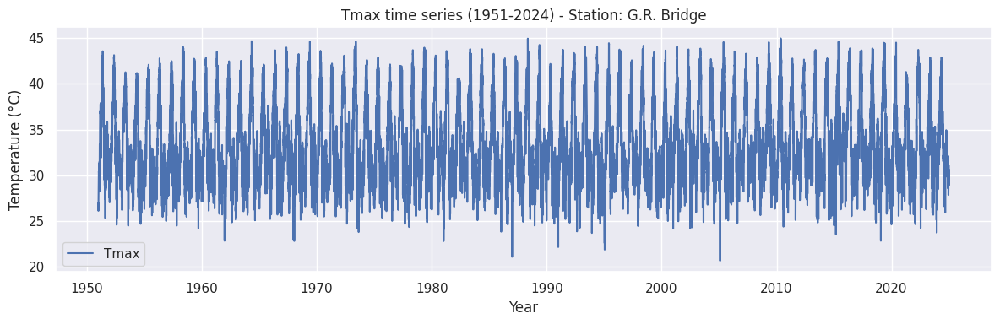

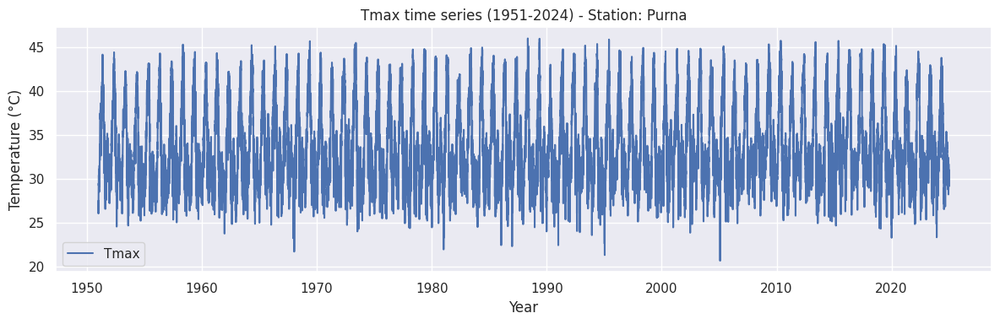

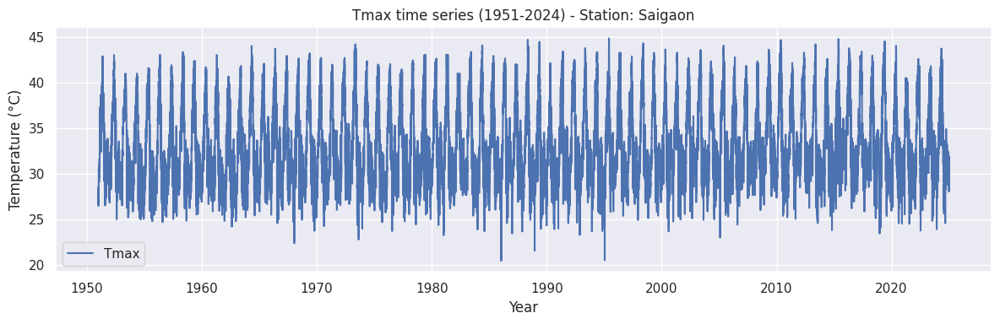

...

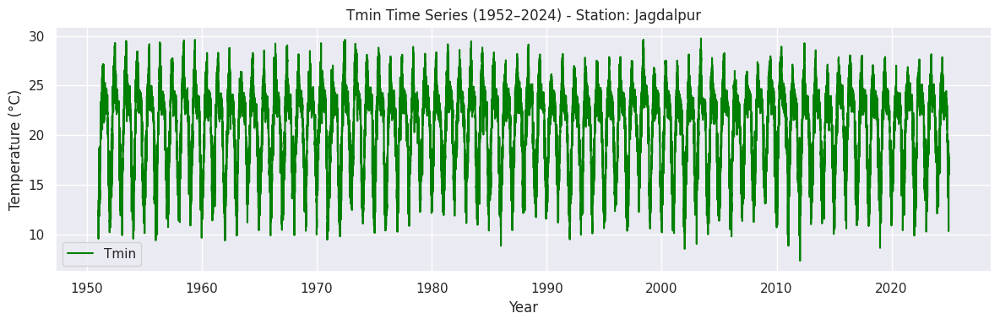

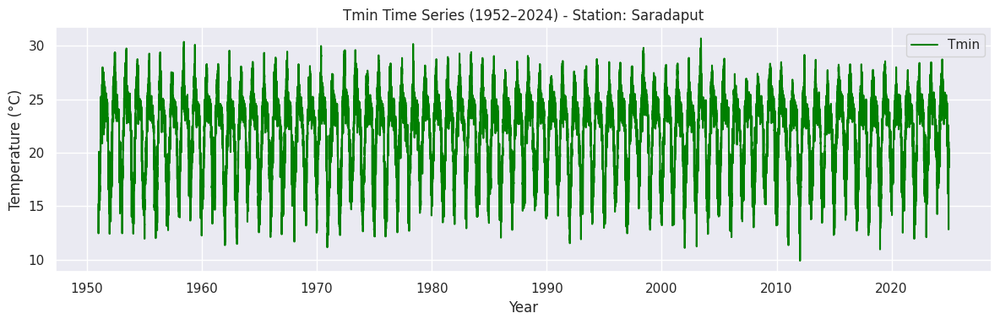

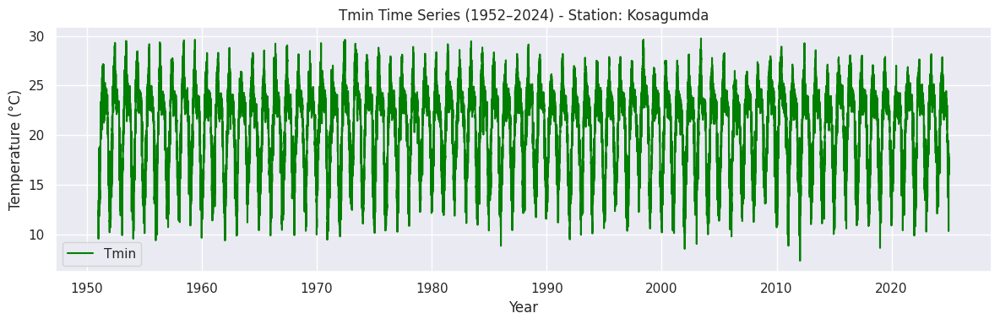

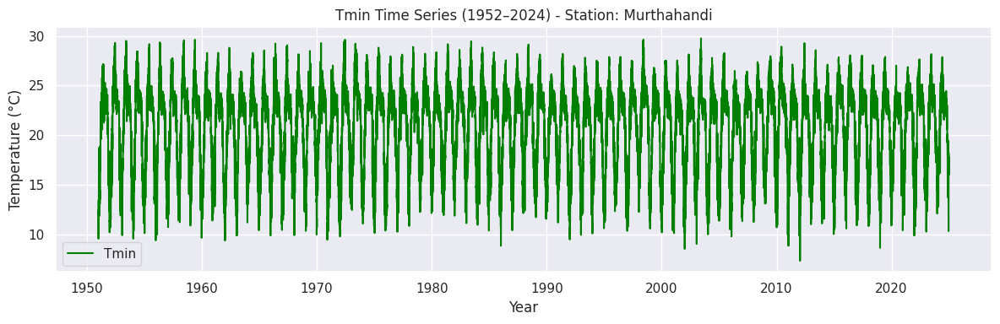

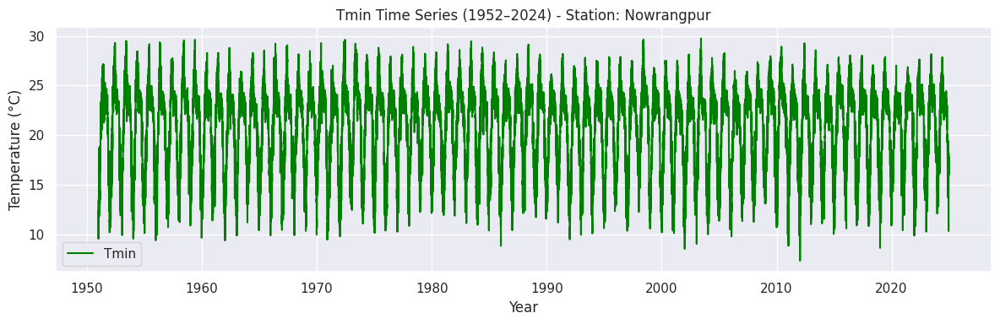

In [16]:
import matplotlib.pyplot as plt
for column in tmax_filtered.columns:
  plt.figure(figsize=(12, 4))
  plt.plot(tmax_filtered.index, tmax_filtered[column], label = 'Tmax')
  plt.title(f"Tmax time series (1951-2024) - Station: {column}")
  plt.xlabel('Year')
  plt.ylabel('Temperature (°C)')
  plt.legend()
  plt.grid(True)
  plt.tight_layout()
  plt.show()

for column in tmin_filtered.columns:
    plt.figure(figsize=(12, 4))
    plt.plot(tmin_filtered.index, tmin_filtered[column], label='Tmin', color='green')
    plt.title(f'Tmin Time Series (1952–2024) - Station: {column}')
    plt.xlabel('Year')
    plt.ylabel('Temperature (°C)')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

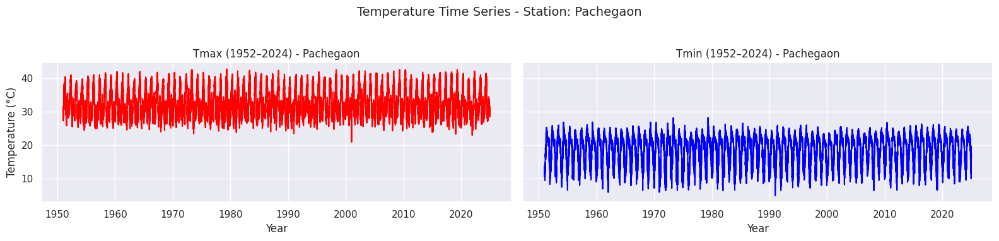

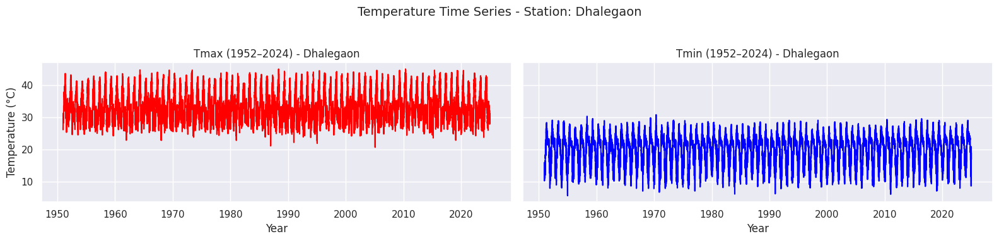

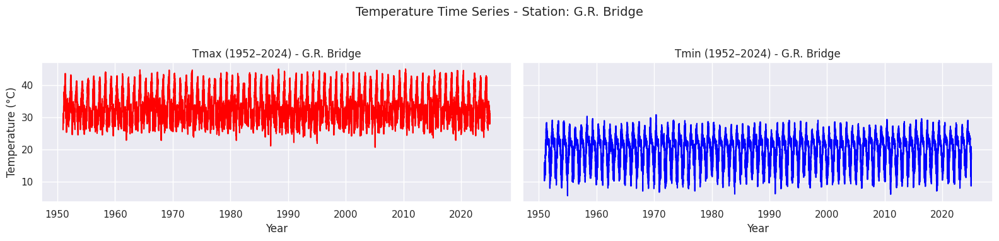

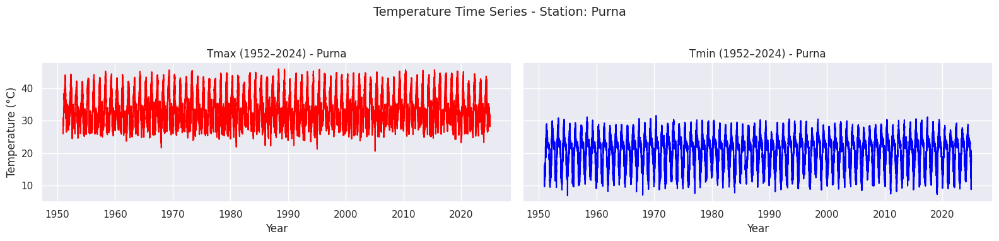

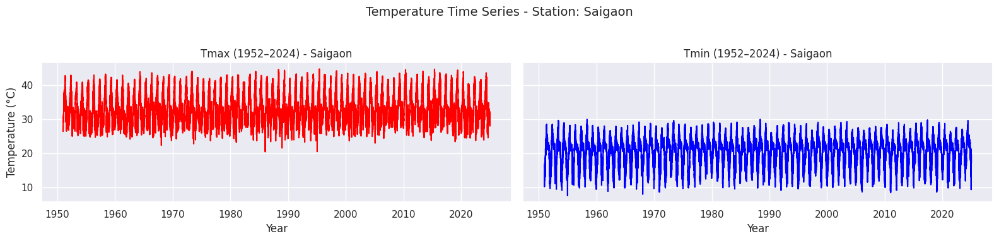

...

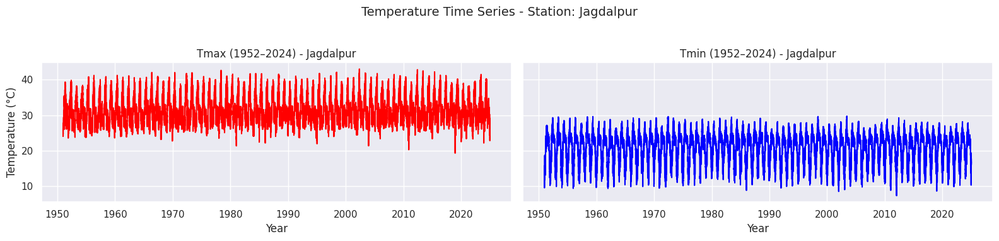

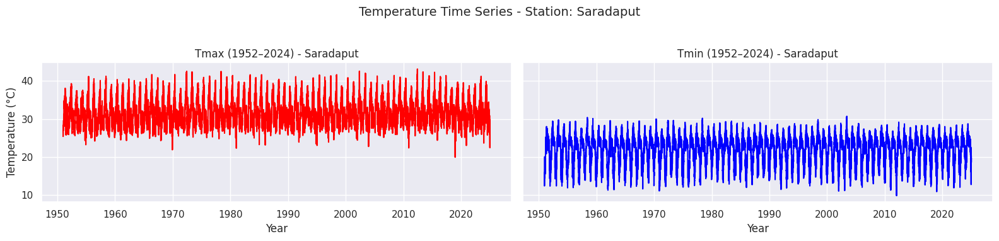

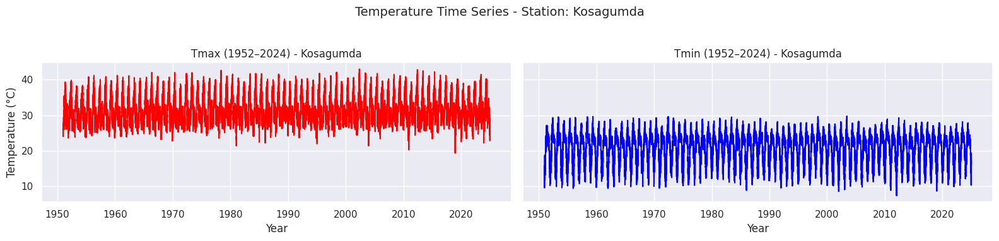

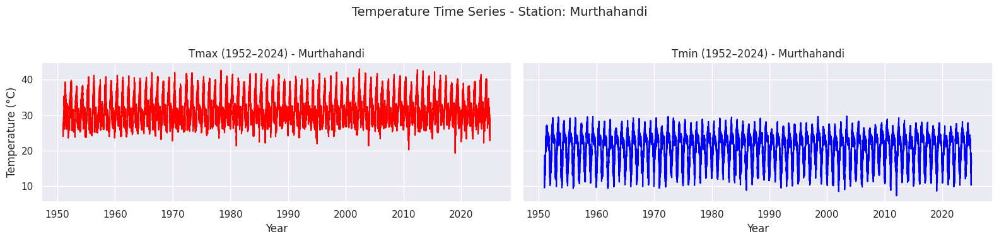

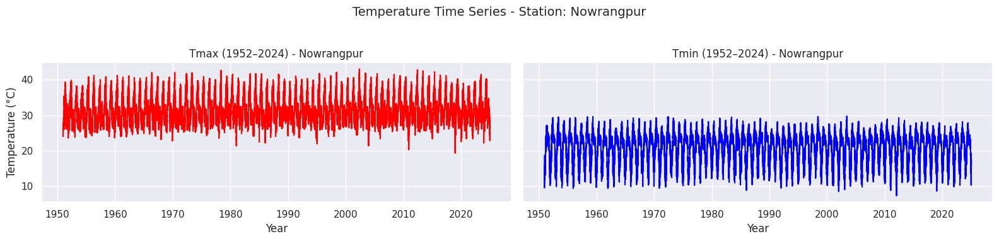

In [18]:
for station in tmax_filtered.columns:
  fig, axes = plt.subplots(1, 2, figsize = (16, 4), sharey= True)
  axes[0].plot(tmax_filtered.index, tmax_filtered[station], color='red')
  axes[0].set_title(f'Tmax (1952–2024) - {station}')
  axes[0].set_xlabel('Year')
  axes[0].set_ylabel('Temperature (°C)')
  axes[0].grid(True)
  axes[1].plot(tmin_filtered.index, tmin_filtered[station], color='blue')
  axes[1].set_title(f'Tmin (1952–2024) - {station}')
  axes[1].set_xlabel('Year')
  axes[1].grid(True)

  plt.suptitle(f'Temperature Time Series - Station: {station}', fontsize=14)
  plt.tight_layout(rect=[0, 0.03, 1, 0.95])
  plt.show()

In [19]:
import pandas as pd

station_df = pd.read_csv('/content/drive/MyDrive/Dissertation_Project/Dissertation_Data/fresh_data_metadata.csv')
station_latitude = dict(zip(station_df['Stn_Name'], station_df['Latitude']))

In [24]:
import numpy as np

def calc_monthly_ra(lat_deg, month):
  lat_rad = np.radians(lat_deg)
  dr = 1 + 0.033 * np.cos(2 * np.pi * month/12)
  solar_decl = 0.409 * np.cos(2 * np.pi * month/12-1.39)
  ws = np.arccos(-np.tan(lat_rad) * np.tan(solar_decl))
  ra = (24 * 60 / np.pi) * 0.0820 * dr * (
      ws * np.sin(lat_rad) * np.sin(solar_decl) + np.cos(lat_rad) * np.cos(solar_decl) * np.sin(ws)
  )
  return ra #in MJ/m2/day


months = pd.date_range(start = '1921-01', end='2024-12', freq = 'MS')
monthly_ra = {
    station: [calc_monthly_ra(lat, date.month) for date in months]
    for station, lat in station_latitude.items()
}
print(monthly_ra)
ra_df = pd.DataFrame(monthly_ra, index=months)
ra_df.to_csv('/content/drive/MyDrive/Dissertation_Project/Ra_MJ_per_m2_per_day_1952_2024.csv')

{'Pachegaon': [np.float64(40.64255146517208), np.float64(41.25370547302522), np.float64(40.69542248660529), np.float64(39.32979024872624), np.float64(36.75513818797407), np.float64(32.77130344238027), np.float64(28.34615226465857), np.float64(25.326849391987697), np.float64(25.238644700343663), np.float64(28.345420116603922), np.float64(33.35349345222154), np.float64(38.00419021322317), np.float64(40.64255146517208), np.float64(41.25370547302522), np.float64(40.69542248660529), np.float64(39.32979024872624), np.float64(36.75513818797407), np.float64(32.77130344238027), np.float64(28.34615226465857), np.float64(25.326849391987697), np.float64(25.238644700343663), np.float64(28.345420116603922), np.float64(33.35349345222154), np.float64(38.00419021322317), np.float64(40.64255146517208), np.float64(41.25370547302522), np.float64(40.69542248660529), np.float64(39.32979024872624), np.float64(36.75513818797407), np.float64(32.77130344238027), np.float64(28.34615226465857), np.float64(25.3268

In [25]:
pet_df = pd.DataFrame(index=months)
for station in tmax_filtered.columns:
    tmax = tmax_filtered[station].values
    tmin = tmin_filtered[station].values
    tmean = (tmax + tmin) / 2
    ra = np.array(monthly_ra[station])

    pet = 0.0023 * ra * (tmean + 17.8) * np.sqrt(tmax - tmin)
    pet_df[station] = pet

ValueError: operands could not be broadcast together with shapes (1248,) (27029,) 

In [27]:
import pandas as pd
import numpy as np

# Ensure tmax_df and tmin_df are DataFrames with datetime index
tmax_monthly = df_tmax.loc['1952':'2024'].resample('M').mean()
tmin_monthly = df_tmin.loc['1952':'2024'].resample('M').mean()

# Compute tmean
tmean_monthly = (tmax_monthly + tmin_monthly) / 2

# Prepare PET DataFrame
pet_df = pd.DataFrame(index=tmean_monthly.index)

# Loop through each station
for station in tmax_monthly.columns:
    tmax = tmax_monthly[station].values
    tmin = tmin_monthly[station].values
    tmean = tmean_monthly[station].values
    ra = np.array(monthly_ra[station])  # Ra must also be length 1248

    # Check all are of the same length
    if len(tmean) == len(tmin) == len(tmax) == len(ra):
        # Hargreaves PET
        pet = 0.0023 * ra * (tmean + 17.8) * np.sqrt(tmax - tmin)
        pet_df[station] = pet
    else:
        print(f"Length mismatch at station {station}")


Length mismatch at station Pachegaon
Length mismatch at station Dhalegaon
Length mismatch at station G.R. Bridge
Length mismatch at station Purna
Length mismatch at station Saigaon
Length mismatch at station Kanergaon
Length mismatch at station Yelli
Length mismatch at station Betmogra
Length mismatch at station Degloor
Length mismatch at station Mangrul
Length mismatch at station Hivra
Length mismatch at station Gandlapet
Length mismatch at station P.G. (Penganga) Bridge
Length mismatch at station Nandgaon
Length mismatch at station Ramakona
Length mismatch at station Satrapur
Length mismatch at station Bamini (Balharsha)
Length mismatch at station Mancherial
Length mismatch at station Bhatpalli
Length mismatch at station Sirpur
Length mismatch at station Rajoli
Length mismatch at station Zari
Length mismatch at station Ashti
Length mismatch at station Somanpally
Length mismatch at station Keolari
Length mismatch at station Salebardi
Length mismatch at station Tekra
Length mismatch at

<ipython-input-27-4262109e3f7c>:5: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  tmax_monthly = df_tmax.loc['1952':'2024'].resample('M').mean()
<ipython-input-27-4262109e3f7c>:6: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  tmin_monthly = df_tmin.loc['1952':'2024'].resample('M').mean()


In [28]:
tmax_filled = df_tmax.resample('D').mean().interpolate('time').loc['1952':'2024']
tmin_filled = df_tmin.resample('D').mean().interpolate('time').loc['1952':'2024']

# Then resample to monthly means
tmax_monthly = tmax_filled.resample('ME').mean()
tmin_monthly = tmin_filled.resample('ME').mean()


In [29]:
for station in tmax_monthly.columns:
    if station not in monthly_ra:
        continue  # Skip if no Ra data for this station

    tmax = tmax_monthly[station].dropna().values
    tmin = tmin_monthly[station].dropna().values
    tmean = ((tmax_monthly[station] + tmin_monthly[station]) / 2).dropna().values
    ra = np.array(monthly_ra[station])

    # All arrays must be the same length
    min_len = min(len(tmax), len(tmin), len(tmean), len(ra))
    if min_len < 1248:
        print(f"Skipping {station}: incomplete data")
        continue

    # Trim all to same length and compute PET
    pet = 0.0023 * ra[:min_len] * (tmean[:min_len] + 17.8) * np.sqrt(tmax[:min_len] - tmin[:min_len])
    pet_df[station] = pet


Skipping Pachegaon: incomplete data
Skipping Dhalegaon: incomplete data
Skipping G.R. Bridge: incomplete data
Skipping Purna: incomplete data
Skipping Saigaon: incomplete data
Skipping Kanergaon: incomplete data
Skipping Yelli: incomplete data
Skipping Betmogra: incomplete data
Skipping Degloor: incomplete data
Skipping Mangrul: incomplete data
Skipping Hivra: incomplete data
Skipping Gandlapet: incomplete data
Skipping P.G. (Penganga) Bridge: incomplete data
Skipping Nandgaon: incomplete data
Skipping Ramakona: incomplete data
Skipping Satrapur: incomplete data
Skipping Bamini (Balharsha): incomplete data
Skipping Mancherial: incomplete data
Skipping Bhatpalli: incomplete data
Skipping Sirpur: incomplete data
Skipping Rajoli: incomplete data
Skipping Zari: incomplete data
Skipping Ashti: incomplete data
Skipping Somanpally: incomplete data
Skipping Keolari: incomplete data
Skipping Salebardi: incomplete data
Skipping Tekra: incomplete data
Skipping Wairagarh: incomplete data
Skipping 